#`Steps of doing Bivariate Analysis`

`Numerical - Numerical`
-  a. You can plot graphs like scatterplot(regression plots), 2D histplot, 2D KDEplots

- b. Check correlation coefficent to check linear relationship

`Numerical - Categorical` - create visualizations that compare the distribution of the numerical data across different categories of the categorical data.

- a. You can plot graphs like barplot, boxplot, kdeplot violinplot even scatterplots

`Categorical - Categorical`
-  a. You can create cross-tabulations or contingency tables that show the distribution of values in one categorical column, grouped by the values in the other categorical column.

- b. You can plots like heatmap, stacked barplots, treemaps.

In [44]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import plotly.express as px
from scipy.stats import stats
import warnings
warnings.filterwarnings("ignore")
from scipy.stats import chi2_contingency
from scipy.stats import f_oneway

In [45]:
df=pd.read_csv('/content/Data_after_Univariate Analysis')

In [46]:
df.shape

(300259, 14)

In [47]:
df.sample(10)

,flight_year,flight_month,is_hoiliday,day_of_week,airline,class,departure_city,departure_time,arrival_city,arrival_time,duration,price,Stops,price_category
155102,2023,7,0,1,GO FIRST,economy,Hyderabad,540,Delhi,875,335,6193,1,Medium
147288,2023,8,0,6,Vistara,economy,Kolkata,1125,Hyderabad,1195,1510,5818,1,Medium
247695,2023,7,0,0,Vistara,business,Bangalore,570,Delhi,1380,810,55664,1,Luxury
163703,2023,7,0,0,Air India,economy,Hyderabad,1090,Mumbai,610,960,7571,2,High
89477,2023,7,0,6,Vistara,economy,Bangalore,420,Delhi,580,160,4547,0,Medium
211617,2023,8,0,2,Vistara,business,Delhi,1190,Mumbai,615,865,53961,1,Luxury
113280,2023,7,0,2,Air India,economy,Bangalore,370,Hyderabad,1415,1045,6686,1,High
251532,2023,7,0,4,Vistara,business,Bangalore,585,Mumbai,1430,845,68009,1,Luxury
22491,2023,7,0,0,Vistara,economy,Delhi,1310,Kolkata,580,710,7883,1,High
204015,2023,7,0,2,GO FIRST,economy,Chennai,1060,Hyderabad,1135,75,1116,0,Low


In [48]:
df=df.drop(columns='flight_year')
df.shape

(300259, 13)

#`So as where less categorical columns in data so we can start our Bivariate analysis with cat-cat column and then categorical with target columns followed by others`

#`First we know how our categorical column relates with each other by statistical test`

In [49]:
pd.crosstab(df['airline'],df['class'])

class,business,economy
airline,,
Air India,32898,47994
AirAsia,0,16098
GO FIRST,0,23177
Indigo,0,43120
SpiceJet,0,9011
StarAir,0,61
Trujet,0,41
Vistara,60589,67270


In [50]:
test_stats,p_value,dof,expected=chi2_contingency(pd.crosstab(df['airline'],df['class']))

In [51]:
print(f"Chi-Square Test: Statistic={test_stats}, p-value={p_value}")

Chi-Square Test: Statistic=60552.44810094634, p-value=0.0


In [52]:
if p_value<0.05:
  print('Significant relationship between Airline and Class')
else:
  print('no Significant relationship between Airline and Class')

Significant relationship between Airline and Class


In [53]:
contingency_table = pd.crosstab(df['airline'], df['departure_city'])
stat, p, dof, expected = chi2_contingency(contingency_table)

print(f"Chi-Square Test: Statistic={stat}, p-value={p}")
if p < 0.05:
    print("Significant relationship between Airline and departure_city ")
else:
    print("No significant relationship")


Chi-Square Test: Statistic=6033.176864189834, p-value=0.0
Significant relationship between Airline and departure_city 


In [54]:

contingency_table = pd.crosstab(df['airline'], df['arrival_city'])
stat, p, dof, expected = chi2_contingency(contingency_table)

print(f"Chi-Square Test: Statistic={stat}, p-value={p}")
if p < 0.05:
    print("Significant relationship between Airline and arrival city")
else:
    print("No significant relationship")

Chi-Square Test: Statistic=6507.579842965123, p-value=0.0
Significant relationship between Airline and arrival city


In [55]:
contingency_table = pd.crosstab(df['arrival_city'], df['departure_city'])
stat, p, dof, expected = chi2_contingency(contingency_table)

print(f"Chi-Square Test: Statistic={stat}, p-value={p}")
if p < 0.05:
    print("Significant relationship between arrival_city and departure_city ")
else:
    print("No significant relationship")

Chi-Square Test: Statistic=64222.04563247142, p-value=0.0
Significant relationship between arrival_city and departure_city 


In [56]:
from scipy.stats import chi2_contingency

contingency_table = pd.crosstab(df['airline'], df['price_category'])
stat, p, dof, expected = chi2_contingency(contingency_table)

print(f"Chi-Square Test: Statistic={stat}, p-value={p}")
if p < 0.05:
    print("Significant relationship between Airline and arrival city")
else:
    print("No significant relationship")

Chi-Square Test: Statistic=112101.0486933449, p-value=0.0
Significant relationship between Airline and arrival city


In [57]:
contingency_table = pd.crosstab(df['price_category'], df['departure_city'])
stat, p, dof, expected = chi2_contingency(contingency_table)

print(f"Chi-Square Test: Statistic={stat}, p-value={p}")
if p < 0.05:
    print("Significant relationship between price_category and departure_city ")
else:
    print("No significant relationship")

Chi-Square Test: Statistic=7631.408911938776, p-value=0.0
Significant relationship between price_category and departure_city 


In [58]:
contingency_table = pd.crosstab(df['airline'], df['Stops'])
stat, p, dof, expected = chi2_contingency(contingency_table)

print(f"Chi-Square Test: Statistic={stat}, p-value={p}")
if p < 0.05:
    print("Significant relationship between airline vs stops ")
else:
    print("No significant relationship")

Chi-Square Test: Statistic=18330.115942170498, p-value=0.0
Significant relationship between airline vs stops 


In [59]:
# Create cross-tabulation between airline and price_category
cross_tab = pd.crosstab(df['airline'], df['price_category']).reset_index()

# Melt to long format for Plotly
heatmap_data = cross_tab.melt(id_vars='airline', var_name='price_category', value_name='Frequency')

# Plot heatmap
fig = px.density_heatmap(
    heatmap_data,
    x='price_category',
    y='airline',
    z='Frequency',
    color_continuous_scale='RdBu',
    text_auto=True,
    title='Heatmap of Airline vs Price Category (Frequency)',
    labels={'airline': 'Airline', 'price_category': 'Price Category', 'Frequency': 'Frequency'}
)

fig.update_layout(width=800, height=400)

fig.show()

In [60]:
# Create a cross-tabulation (frequency table)
cross_tab = pd.crosstab(df['airline'], df['class']).reset_index()

# Melt the cross-tab to long format for Plotly
heatmap_data = cross_tab.melt(id_vars='airline', var_name='class', value_name='Frequency')

# Plot heatmap
fig = px.density_heatmap(
    heatmap_data,
    x='class',
    y='airline',
    z='Frequency',
    color_continuous_scale='RdBu',
    text_auto=True,
    title='Heatmap of Airline vs Class (Frequency)',
    labels={'airline': 'Airline', 'class': 'Class', 'Frequency': 'Frequency'}
)

fig.update_layout(
    width=800,
    height=400
)

fig.show()

In [61]:
# Create cross-tabulation between airline and departure_city
cross_tab = pd.crosstab(df['airline'], df['departure_city']).reset_index()

# Melt to long format for Plotly
heatmap_data = cross_tab.melt(id_vars='airline', var_name='departure_city', value_name='Frequency')

# Plot heatmap
fig = px.density_heatmap(
    heatmap_data,
    x='departure_city',
    y='airline',
    z='Frequency',
    color_continuous_scale='RdBu',
    text_auto=True,
    title='Heatmap of Airline vs Departure City (Frequency)',
    labels={'airline': 'Airline', 'departure_city': 'Departure City', 'Frequency': 'Frequency'}
)

fig.update_layout(width=900, height=500)

fig.show()

In [62]:
# Create cross-tabulation between airline and arrival_city
cross_tab = pd.crosstab(df['airline'], df['arrival_city']).reset_index()

# Melt to long format for Plotly
heatmap_data = cross_tab.melt(id_vars='airline', var_name='arrival_city', value_name='Frequency')

# Plot heatmap
fig = px.density_heatmap(
    heatmap_data,
    x='arrival_city',
    y='airline',
    z='Frequency',
    color_continuous_scale='RdBu',
    text_auto=True,
    title='Heatmap of Airline vs Arrival City (Frequency)',
    labels={'airline': 'Airline', 'arrival_city': 'Arrival City', 'Frequency': 'Frequency'}
)

fig.update_layout(width=900, height=500)

fig.show()

In [63]:
# Create cross-tabulation between airline and Stops
cross_tab = pd.crosstab(df['airline'], df['Stops']).reset_index()

# Melt to long format for Plotly
heatmap_data = cross_tab.melt(id_vars='airline', var_name='Stops', value_name='Frequency')

# Plot heatmap
fig = px.density_heatmap(
    heatmap_data,
    x='Stops',
    y='airline',
    z='Frequency',
    color_continuous_scale='RdBu',
    text_auto=True,
    title='Heatmap of Airline vs Stops (Frequency)',
    labels={'airline': 'Airline', 'Stops': 'Stops', 'Frequency': 'Frequency'}
)

fig.update_layout(width=800, height=400)

fig.show()

#`categorical with target columns`

In [64]:
from scipy.stats import f_oneway

categorical_cols = ['airline', 'class', 'departure_city', 'arrival_city', 'day_of_week', 'Stops']
alpha = 0.05  # significance level

print("ANOVA Results (Significance Level = 0.05):\n")

for col in categorical_cols:
    groups = [group['price'].values for name, group in df.groupby(col)]
    f_stat, p_val = f_oneway(*groups)

    significance = "Significant" if p_val < alpha else "Not Significant"
    print(f"{col} -> F-statistic: {f_stat:.4f}, P-value: {p_val:.4e} ({significance})")


ANOVA Results (Significance Level = 0.05):

airline -> F-statistic: 12286.8093, P-value: 0.0000e+00 (Significant)
class -> F-statistic: 2199951.2055, P-value: 0.0000e+00 (Significant)
departure_city -> F-statistic: 144.9462, P-value: 3.4013e-154 (Significant)
arrival_city -> F-statistic: 192.5247, P-value: 1.5944e-205 (Significant)
day_of_week -> F-statistic: 13.6079, P-value: 1.6397e-15 (Significant)
Stops -> F-statistic: 6476.5122, P-value: 0.0000e+00 (Significant)


#`AS all of the categorical columns have significant relation with target variable price`

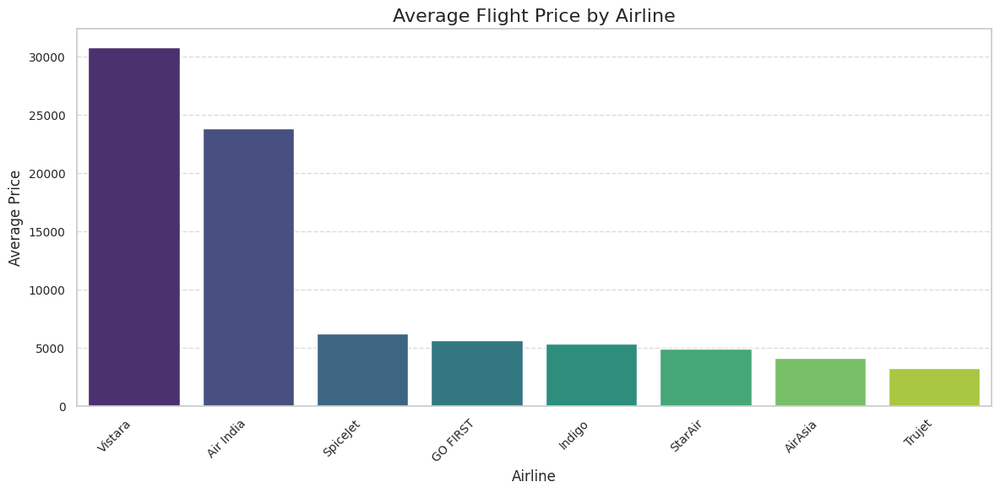

In [65]:
# Set style
sns.set(style='whitegrid')

# Sort airlines by average price (optional)
sorted_df = df.groupby('airline')['price'].mean().sort_values(ascending=False).reset_index()

plt.figure(figsize=(12, 6))
sns.barplot(
    data=sorted_df,
    x='airline',
    y='price',
    palette='viridis'
)

plt.title('Average Flight Price by Airline', fontsize=16)
plt.xlabel('Airline', fontsize=12)
plt.ylabel('Average Price', fontsize=12)
plt.xticks(rotation=45, ha='right', fontsize=10)
plt.yticks(fontsize=10)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

In [66]:
fig = px.violin(
    df,
    x='airline',
    y='price',
    box=True,
    color='airline',        # Optional: color by airline
    title='Distribution of Flight Prices by Airline',
)

fig.update_layout(
    width=1000,
    height=500,
    xaxis_title='Airline',
    yaxis_title='Price',
    title_x=0.5,  # Center the title
    font=dict(size=12),
    showlegend=False
)

fig.show()

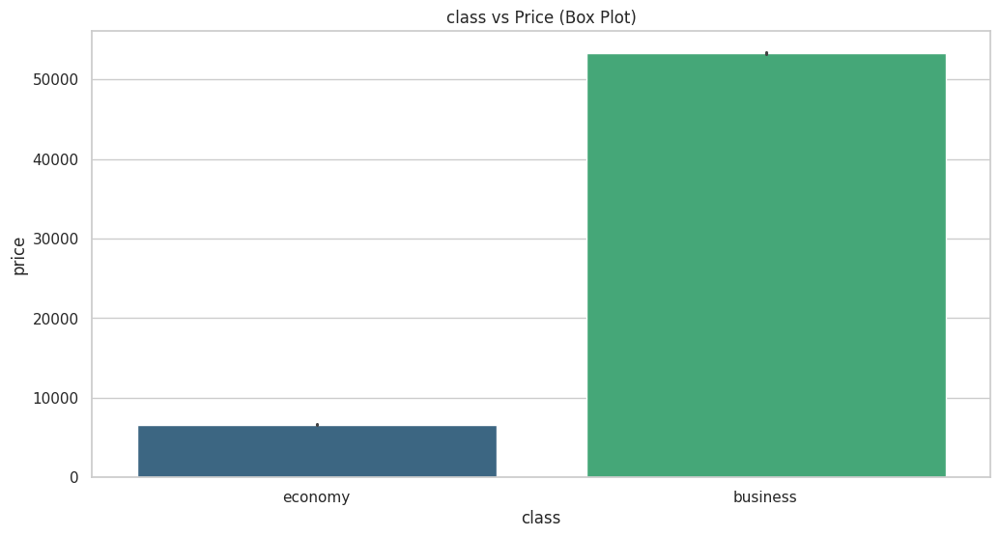

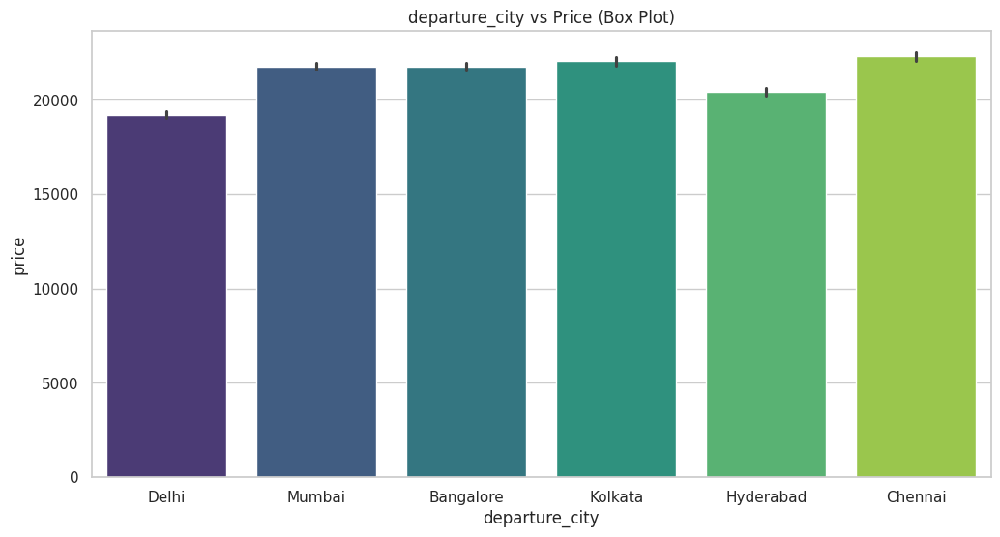

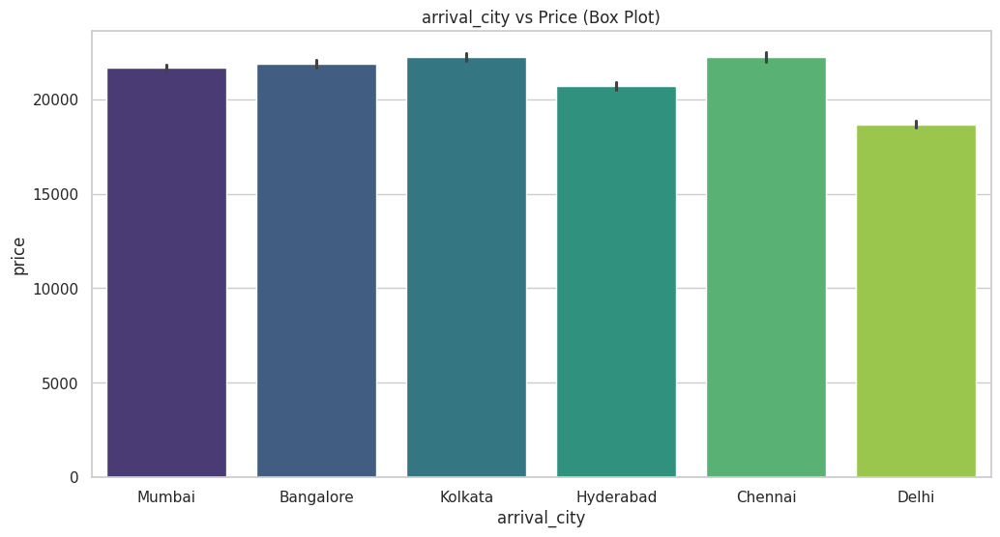

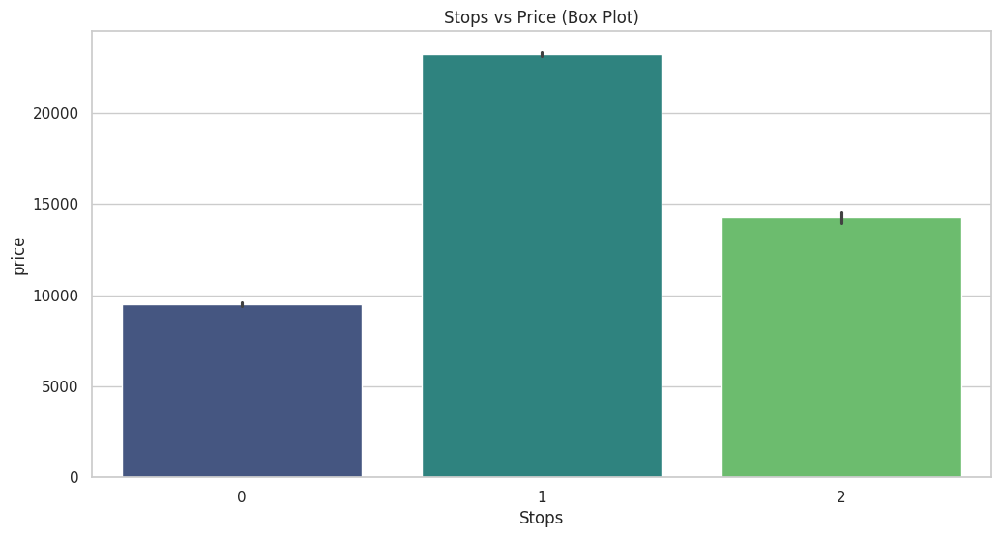

In [67]:
categorical_cols = ['class', 'departure_city', 'arrival_city', 'Stops']

for col in categorical_cols:
    plt.figure(figsize=(12, 6))
    sns.barplot(df, x=col, y='price', palette='viridis')
    plt.title(f'{col} vs Price (Box Plot)')
    plt.show()

In [68]:
categorical_cols = ['class', 'departure_city', 'arrival_city', 'Stops']

for col in categorical_cols:
    plt.figure(figsize=(12, 6))
    fig=px.box(df, x=col, y='price',title=f'{col} vs Price (Box Plot)')
    fig.show()

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

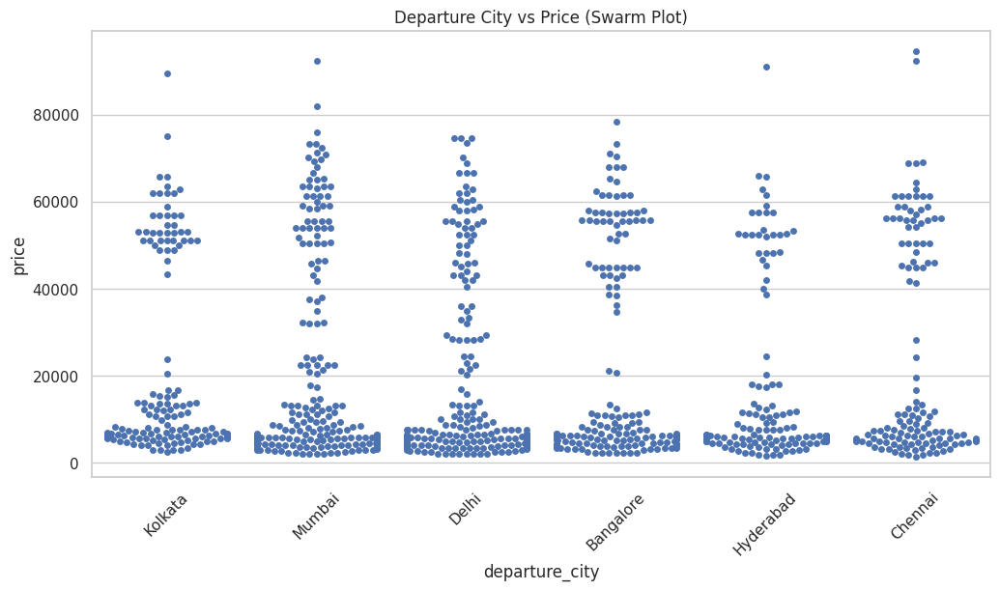

In [69]:
plt.figure(figsize=(12, 6))
sns.swarmplot(data=df.sample(1000), x='departure_city', y='price')
plt.title('Departure City vs Price (Swarm Plot)')
plt.xticks(rotation=45)
plt.show()

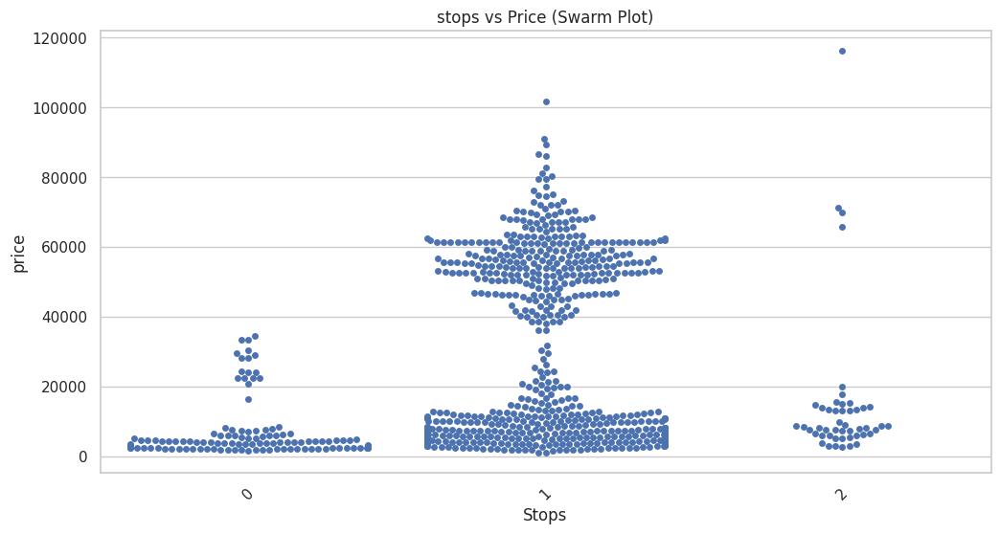

In [70]:
plt.figure(figsize=(12, 6))
sns.swarmplot(data=df.sample(1000), x='Stops', y='price')
plt.title('stops vs Price (Swarm Plot)')
plt.xticks(rotation=45)
plt.show()

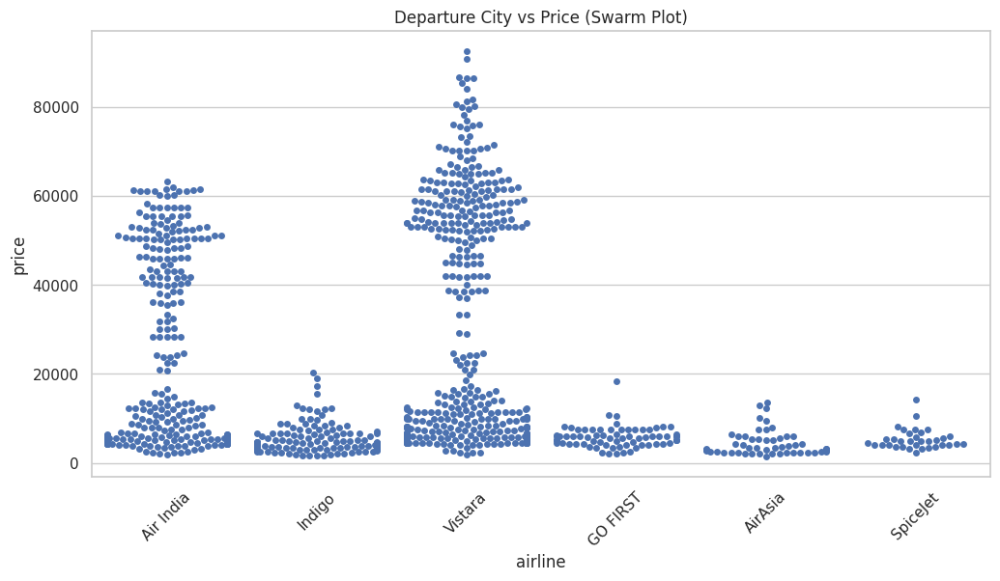

In [71]:
plt.figure(figsize=(12, 6))
sns.swarmplot(data=df.sample(1000), x='airline', y='price')
plt.title('Departure City vs Price (Swarm Plot)')
plt.xticks(rotation=45)
plt.show()

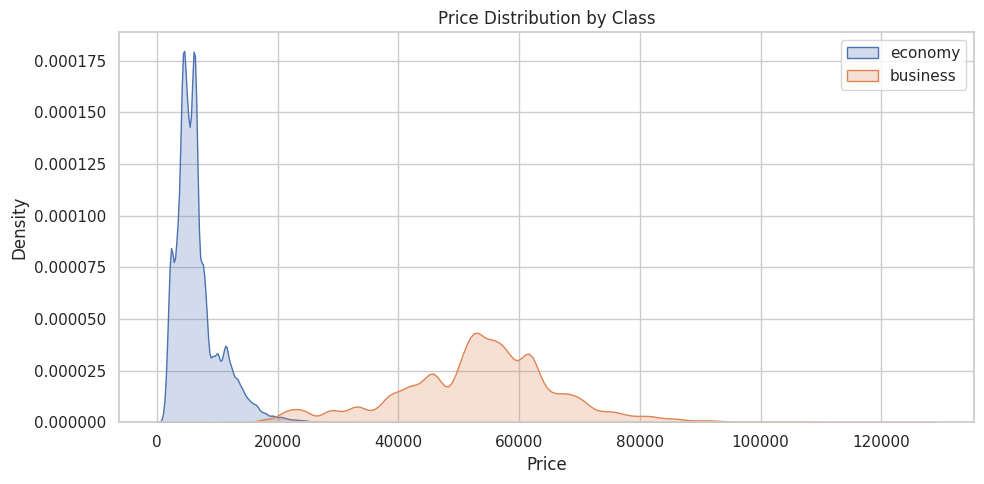

In [72]:
plt.figure(figsize=(10, 5))
for category in df['class'].unique():
    sns.kdeplot(df[df['class'] == category]['price'], label=category, fill=True)

plt.title('Price Distribution by Class')
plt.xlabel('Price')
plt.ylabel('Density')
plt.legend()
plt.tight_layout()
plt.show()

<Axes: xlabel='class', ylabel='price'>

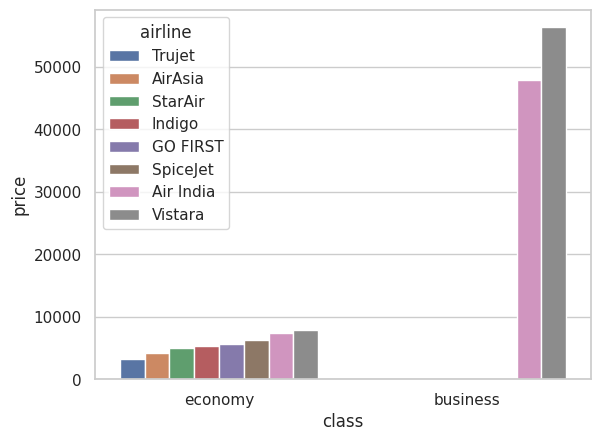

In [73]:
df2=df.groupby(["airline","class"]).agg({"price":"mean"}).reset_index().sort_values(by='price')
sns.barplot(x='class',y='price',data=df2,hue='airline')

In [74]:
df2=df.groupby(["day_of_week","flight_month"]).agg({"price":"mean"}).reset_index().sort_values(by='price')
fig = px.bar(
    df2,
    x='day_of_week',
    y='price',
    color='flight_month',
    barmode='group',  # group bars side-by-side
    text_auto='.2s',  # optional: show values
    title='Average Price by Day of Week and Flight Month',
    labels={'day_of_week': 'Day of Week', 'price': 'Average Price', 'flight_month': 'Flight Month'}
)

fig.update_layout(
    width=900,
    height=500,
    xaxis=dict(type='category'),
    bargap=0.2
)

fig.show()

In [75]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 300259 entries, 0 to 300258
Data columns (total 13 columns):
 #   Column          Non-Null Count   Dtype 
---  ------          --------------   ----- 
 0   flight_month    300259 non-null  int64 
 1   is_hoiliday     300259 non-null  int64 
 2   day_of_week     300259 non-null  int64 
 3   airline         300259 non-null  object
 4   class           300259 non-null  object
 5   departure_city  300259 non-null  object
 6   departure_time  300259 non-null  int64 
 7   arrival_city    300259 non-null  object
 8   arrival_time    300259 non-null  int64 
 9   duration        300259 non-null  int64 
 10  price           300259 non-null  int64 
 11  Stops           300259 non-null  int64 
 12  price_category  300259 non-null  object
dtypes: int64(8), object(5)
memory usage: 29.8+ MB


#`numerical type data`

In [76]:
df.select_dtypes('number').corr()

,flight_month,is_hoiliday,day_of_week,departure_time,arrival_time,duration,price,Stops
flight_month,1.000000,-0.235596,0.081153,-0.006680,-0.017885,-0.037899,-0.071457,-0.007074
is_hoiliday,-0.235596,1.000000,0.105946,0.004771,0.001665,0.014175,0.012294,0.001081
day_of_week,0.081153,0.105946,1.000000,-0.004939,-0.007443,-0.011846,-0.010413,0.000095
departure_time,-0.006680,0.004771,-0.004939,1.000000,-0.155489,0.142512,0.032687,-0.061124
arrival_time,-0.017885,0.001665,-0.007443,-0.155489,1.000000,-0.020165,0.076400,0.064080
duration,-0.037899,0.014175,-0.011846,0.142512,-0.020165,1.000000,0.204300,0.468134
price,-0.071457,0.012294,-0.010413,0.032687,0.076400,0.204300,1.000000,0.119549
Stops,-0.007074,0.001081,0.000095,-0.061124,0.064080,0.468134,0.119549,1.000000


In [88]:
# Compute correlation matrix
corr_matrix =  df[['flight_month', 'is_hoiliday', 'day_of_week', 'departure_time',
           'arrival_time', 'duration', 'price']].corr().round(2)

# Convert to long format
corr_long = corr_matrix.reset_index().melt(id_vars='index')
corr_long.columns = ['Variable1', 'Variable2', 'Correlation']

# Plot heatmap
fig = px.imshow(
    corr_matrix,
    text_auto=True,
    color_continuous_scale='RdBu',
    aspect='auto',
    title='Correlation Heatmap (Numerical Features)'
)

fig.update_layout(
    width=800,
    height=600,
    xaxis_title='Variables',
    yaxis_title='Variables'
)

fig.show()

In [78]:
df.select_dtypes('number').columns

Index(['flight_month', 'is_hoiliday', 'day_of_week', 'departure_time',
       'arrival_time', 'duration', 'price', 'Stops'],
      dtype='object')

In [79]:
data=df.groupby('flight_month')['price'].agg(func='mean').reset_index().sort_values(by='price',ascending=False)
data

,flight_month,price
0,6,27486.033267
1,7,21228.673049
2,8,19470.085473


In [80]:
fig = px.line(
    data,
    x='flight_month',
    y='price',
    markers=True,  # adds dots on line
    title='Line Plot of Price vs Flight Month',
    labels={'flight_month': 'Flight Month', 'price': 'Price'}
)

fig.update_traces(line=dict(color='royalblue'), marker=dict(size=6))
fig.update_layout(width=800, height=400)
fig.show()

In [81]:
data=df.groupby('day_of_week')['price'].agg(func='mean').reset_index()
data

,day_of_week,price
0,0,21086.757683
1,1,21807.089096
2,2,21734.257276
3,3,20998.052573
4,4,20843.018233
5,5,20933.821571
6,6,20862.716710


In [82]:
fig = px.line(
    data,
    x='day_of_week',
    y='price',
    markers=True,  # adds dots on line
    title='Line Plot of Price vs day_of_week',
    labels={'day_of_week': 'Day of week', 'price': 'Price'}
)

fig.update_traces(line=dict(color='royalblue'), marker=dict(size=6))
fig.update_layout(width=800, height=400)
fig.show()

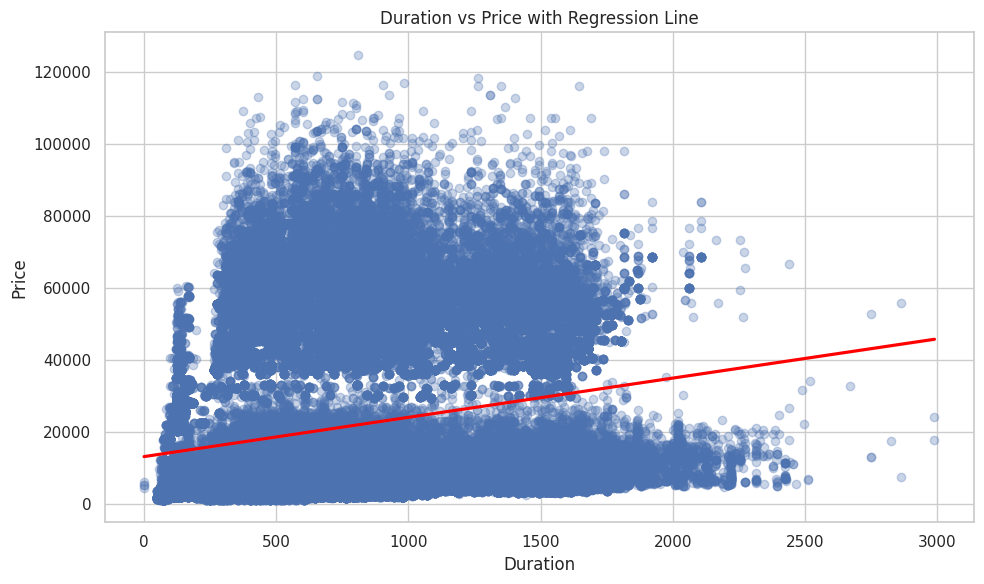

In [86]:
plt.figure(figsize=(10, 6))
sns.regplot(data=df, x='duration', y='price', scatter_kws={'alpha':0.3}, line_kws={'color':'red'})
plt.title('Duration vs Price with Regression Line')
plt.xlabel('Duration')
plt.ylabel('Price')
plt.tight_layout()
plt.show()

In [89]:
px.scatter(x=df['departure_time'],y=df['price'])

In [90]:
px.scatter(x=df['arrival_time'],y=df['price'])

In [ ]:
px.scatter(x=df['arrival_time'],y=df['price'],)

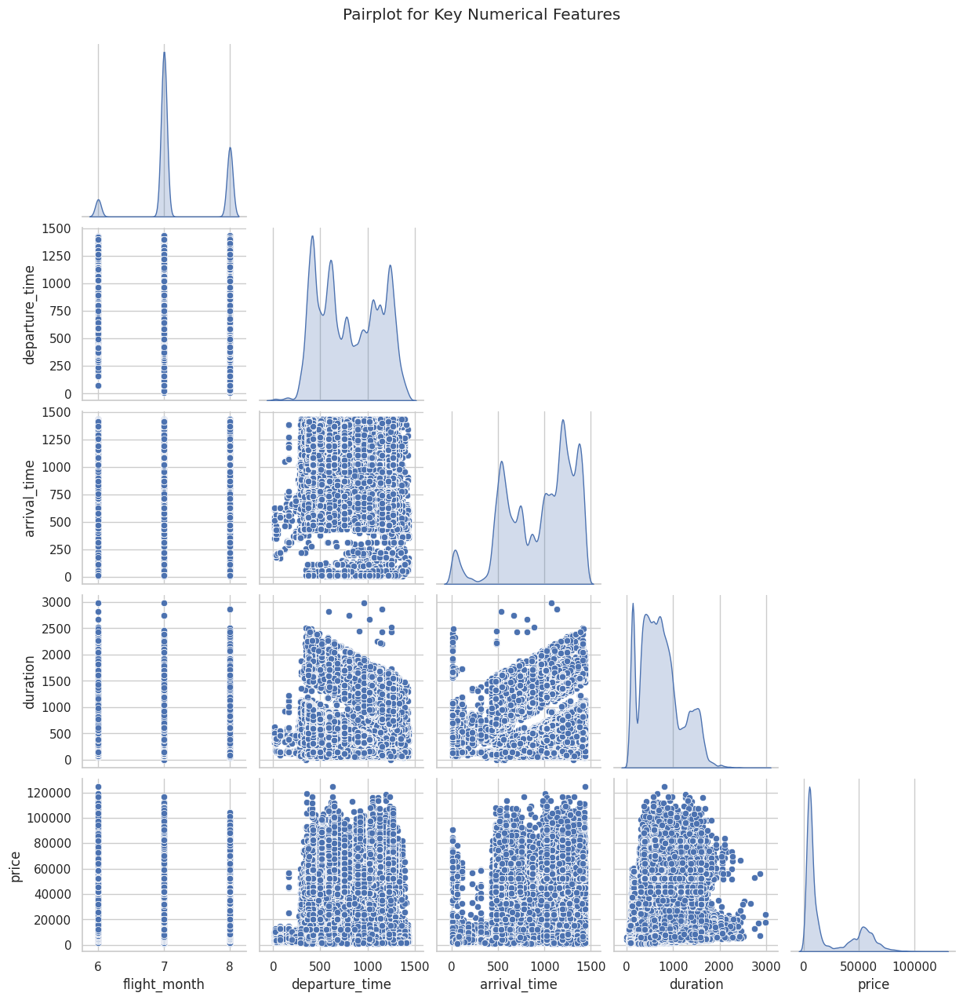

In [87]:
numerical_cols = ['flight_month', 'departure_time', 'arrival_time', 'duration', 'price']
sns.pairplot(df[numerical_cols], corner=True, diag_kind='kde')
plt.suptitle("Pairplot for Key Numerical Features", y=1.02)
plt.show()

In [84]:
fig = px.sunburst(
    df,
    path=['airline', 'class', 'price_category'],  # hierarchy from outer to inner ring
    values='price',
    color='price',
    color_continuous_scale='Sunset',
    title='Sunburst Plot of Flight Prices by Airline, Class, and Price Category'
)

fig.show()

In [85]:
fig = px.treemap(
    df,
    path=['airline', 'class', 'departure_city'],
    values='price',
    color='price',
    color_continuous_scale='Tealrose',
    title='Treemap of Flight Prices by Airline, Class, and Departure City'
)

fig.show()

#`your data has skewed distributions so IQR is best for outliers treatment , as it works well for non-normal data.`

In [97]:
column_name = "price"  # Change this to your target column

Q1 = df[column_name].quantile(0.25)
Q3 = df[column_name].quantile(0.75)
IQR = Q3 - Q1

lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Detect outliers
outliers = df[(df[column_name] < lower_bound) | (df[column_name] > upper_bound)]
outliers.shape

(122, 13)

In [100]:
df=df[~((df[column_name] < lower_bound) | (df[column_name] > upper_bound))]
df.shape

(300137, 13)

In [102]:
column_name = "duration"  # Change this to your target column

Q1 = df[column_name].quantile(0.25)
Q3 = df[column_name].quantile(0.75)
IQR = Q3 - Q1

lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Detect outliers
outliers_duration= df[(df[column_name] < lower_bound) | (df[column_name] > upper_bound)]
outliers_duration.shape

(2004, 13)

In [104]:
df=df[~((df[column_name] < lower_bound) | (df[column_name] > upper_bound))]
df.shape

(298133, 13)

In [106]:
df.sample(10)

,flight_month,is_hoiliday,day_of_week,airline,class,departure_city,departure_time,arrival_city,arrival_time,duration,price,Stops,price_category
143318,7,0,1,Vistara,economy,Kolkata,1225,Hyderabad,755,970,12332,1,Very High
184390,7,0,0,SpiceJet,economy,Chennai,385,Delhi,1310,925,4088,1,Low
277825,7,0,1,Vistara,business,Hyderabad,1235,Mumbai,1060,1265,83143,1,Luxury
184728,7,0,2,Vistara,economy,Chennai,750,Delhi,1240,490,5021,1,Medium
62710,7,0,1,Indigo,economy,Mumbai,765,Kolkata,1190,425,9947,2,High
262767,7,0,4,Air India,business,Kolkata,1135,Delhi,780,1085,48800,1,Very High
126441,8,0,0,Air India,economy,Kolkata,1140,Delhi,830,1130,4185,1,Low
290787,7,0,6,Vistara,business,Chennai,1265,Mumbai,1145,1320,87777,1,Luxury
216108,6,1,3,Vistara,business,Delhi,620,Kolkata,1195,575,66512,1,Luxury
134078,8,0,4,SpiceJet,economy,Kolkata,915,Mumbai,885,1410,7188,1,High


In [107]:
df.to_csv('data_after_eda_Bivariate_&_multivariate_analysis',index=False)